# Shapenet Rendering
- Blender script source: https://github.com/panmari/stanford-shapenet-renderer

## Semantic Segmentation
References:
- https://blender.stackexchange.com/questions/79595/change-diffuse-shader-to-emission-shader-without-affecting-shader-color
- https://blender.stackexchange.com/questions/80906/create-a-segmentation-picture-with-each-object-class-rendered-in-different-color/162746#162746
- https://blender.stackexchange.com/questions/34609/is-there-a-way-to-streamline-scripting-these-shaders-and-modifier-keyframes
- https://github.com/DIYer22/bpycv#install

In [4]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [5]:
import os
import sys
import json
import glob
import cv2
import imageio
import shutil

import subprocess
import numpy as np

import modules.ShapeNet
import modules.utils
import modules.BackgroundImages

from IPython.display import Image, display

# Load ShapeNet Handler

In [6]:
shapenet_root = "/hdd/mliuzzolino/ShapeNet/data/ShapeNetCore.v2"
shapenet_handler = modules.ShapeNet.Handler(shapenet_root)

## Print available categories by name
- Can use name to condition random sampling

In [7]:
# shapenet_handler.print_categories()

## Randomly Sample a filepath

In [8]:
temp_obj_filepath, temp_synset_id, temp_instance_id, temp_obj_name = shapenet_handler.sample_obj(category_name='car')

## Output Path

In [140]:
_MODE = 'generate' # demo, generate

In [141]:
_OUTPUT_ROOT = 'render_output'

# Render

In [142]:
_N_VIEW_ANGLES = 72
_N_MODELS_TO_RENDER = 500
_RANDOM_SCALING = False
_OCCLUSIONS_ACTIVE = False
_OVERWRITE = True
_LAMP_MODE = 'random' if _MODE == 'generate' else 'follow_camera'
_RENDER_ENGINE = 'BLENDER_RENDER' # 'CYCLES', 'BLENDER_RENDER'
_RENDER_SCRIPT = "scripts/blender_render.py"
_TARGET_CATEGORY_LIST = []#['airplane', 'car']

## Run Blender

In [143]:
subprocess_outputs = []
try:
    for img_i in range(_N_MODELS_TO_RENDER):
        # Randomly select target category
        target_category = ''
        if _TARGET_CATEGORY_LIST != []:
            target_category = np.random.choice(_TARGET_CATEGORY_LIST)
        
        # Sample object filepath
        obj_filepath, synset_id, instance_id, obj_name = shapenet_handler.sample_obj(category_name=target_category)
        
        # Setup outpath
        output_root = os.path.join(_OUTPUT_ROOT, _MODE, _RENDER_ENGINE, f'synsetID_{synset_id}', instance_id)
        
        # Randomly select obj scaling
        random_scale = np.random.uniform(0.99, 1.15) if _RANDOM_SCALING else 1.0
        random_n_occlusions = np.random.randint(3, 7) if _OCCLUSIONS_ACTIVE else 0 
        
        if not os.path.exists(output_root) or _OVERWRITE:
            # Remove previous directory if overwrite
            if _OVERWRITE and os.path.exists(output_root):
                shutil.rmtree(output_root)
            
            # Run blender script
            cmd = f"blender --background --python {_RENDER_SCRIPT} -- "
            cmd += f"--output_folder {output_root} --views {_N_VIEW_ANGLES} "
            cmd += f"--render_mode {_MODE} "
            cmd += f"--scale {random_scale} --n_occlusions {random_n_occlusions} "
            cmd += f"--render_engine {_RENDER_ENGINE} "
            cmd += f"--lamp_mode {_LAMP_MODE} " 
            cmd += f"{obj_filepath}"
            out = subprocess.check_output(cmd.split(" "), shell=False)
            subprocess_outputs.append(out)
        else:
            print("Skipping.")
        
        # Stdout
        stdout_str = f"[{img_i+1}/{_N_MODELS_TO_RENDER}] -- "
        stdout_str += f"SynsetID: {synset_id} -- "
        stdout_str += f"InstanceID: {instance_id:32s} -- "
        stdout_str += f"Name: {obj_name}"
        print(stdout_str)
        
except KeyboardInterrupt:
    try:
        # Try to cleanup directory with incomplete # renders
        if len(os.listdir(output_root)) != _N_VIEW_ANGLES:
            shutil.rmtree(output_root)
    except:
        pass
    print("\nEnding early.")

[1/500] -- SynsetID: 03046257 -- InstanceID: bd3924dc45097f029ba80f08c401fbed -- Name: clock
[2/500] -- SynsetID: 03085013 -- InstanceID: 442a30c7e3d4f820cb07c68667cfdc00 -- Name: computer keyboard,keypad
[3/500] -- SynsetID: 02880940 -- InstanceID: b5d1f064841b476dba5342d638d0c267 -- Name: bowl
[4/500] -- SynsetID: 04099429 -- InstanceID: 5a7f14f4b25dd99ceae5cab1248d1ec6 -- Name: rocket,projectile
[5/500] -- SynsetID: 03624134 -- InstanceID: c141abaec55e87e691687e259c21528d -- Name: knife
[6/500] -- SynsetID: 03948459 -- InstanceID: b62475e6bfcc88a226735d0798dfa389 -- Name: pistol,handgun,side arm,shooting iron
[7/500] -- SynsetID: 03642806 -- InstanceID: 298cf1c20abcd641f9f562601150287  -- Name: laptop,laptop computer
[8/500] -- SynsetID: 02801938 -- InstanceID: b9a555f6ce431c8a3adfd94cc5954055 -- Name: basket,handbasket
[9/500] -- SynsetID: 04460130 -- InstanceID: edf288c16aa9797a4d423544e7c5cb27 -- Name: tower
[10/500] -- SynsetID: 03593526 -- InstanceID: 9cabda39008f86316d075d8d4f

[77/500] -- SynsetID: 02942699 -- InstanceID: b22e56fdf18e2eb8968b65a7871de463 -- Name: camera,photographic camera
[78/500] -- SynsetID: 02946921 -- InstanceID: 38dd2a8d2c984e2b6c1cd53dbc9f7b8e -- Name: can,tin,tin can
[79/500] -- SynsetID: 03991062 -- InstanceID: 98a107d314d1b149148a76a78b10eb5d -- Name: pot,flowerpot
[80/500] -- SynsetID: 03710193 -- InstanceID: bfc242ae3d98762ece876412f61273f0 -- Name: mailbox,letter box
[81/500] -- SynsetID: 02876657 -- InstanceID: 59d7b4e7bc3c5d9d99fbba385cc0d41d -- Name: bottle
[82/500] -- SynsetID: 03513137 -- InstanceID: 58fe8b9f7026cd2bf1c20b7f59bbc099 -- Name: helmet
[83/500] -- SynsetID: 02843684 -- InstanceID: f04ba261ea073ef9390cc49064ed7b4d -- Name: birdhouse
[84/500] -- SynsetID: 03001627 -- InstanceID: a56e201584ad5afb61ad1cb92b23bf5  -- Name: chair
[85/500] -- SynsetID: 03085013 -- InstanceID: 657c0de244576d26add3e496533730f  -- Name: computer keyboard,keypad
[86/500] -- SynsetID: 04530566 -- InstanceID: 4b491c434e9c230c9e450dd115401ef

[156/500] -- SynsetID: 03761084 -- InstanceID: 4b896032652578d8b5d95a89c22ce403 -- Name: microwave,microwave oven
[157/500] -- SynsetID: 02942699 -- InstanceID: d1a3482c576f8c50592ecd319dfd8c5d -- Name: camera,photographic camera
[158/500] -- SynsetID: 04379243 -- InstanceID: 71a26c00d3a4bf834397d3416be8cfe5 -- Name: table
[159/500] -- SynsetID: 03207941 -- InstanceID: 503b4dff71b404dabf195d81040cc60  -- Name: dishwasher,dish washer,dishwashing machine
[160/500] -- SynsetID: 02946921 -- InstanceID: dc815e056c71e2ed7c8ed5da8582ce91 -- Name: can,tin,tin can
[161/500] -- SynsetID: 04090263 -- InstanceID: 9fc9bed98828febed4713685ae50fa13 -- Name: rifle
[162/500] -- SynsetID: 02946921 -- InstanceID: a087f6b5ea424ccc785f06f424b9d06  -- Name: can,tin,tin can
[163/500] -- SynsetID: 04099429 -- InstanceID: cdc4b9b25334ee6f789a31ba8b4b1248 -- Name: rocket,projectile
[164/500] -- SynsetID: 02801938 -- InstanceID: 87d80e10b71ebc1f7846915cc11caff4 -- Name: basket,handbasket
[165/500] -- SynsetID: 0

[231/500] -- SynsetID: 02871439 -- InstanceID: 7bbd940fe725689fd320119b2e676c6a -- Name: bookshelf
[232/500] -- SynsetID: 03513137 -- InstanceID: fe47f10f637b54594e5e6ac3ef6bff73 -- Name: helmet
[233/500] -- SynsetID: 03759954 -- InstanceID: f3bb6ffcfc132f34418c7dc49421509  -- Name: microphone,mike
[234/500] -- SynsetID: 03325088 -- InstanceID: b3271d0ad091e15ec36fb70296e45483 -- Name: faucet,spigot
[235/500] -- SynsetID: 03046257 -- InstanceID: c9dd71db5e6713937d0fed3563de13d  -- Name: clock
[236/500] -- SynsetID: 02747177 -- InstanceID: fd013bea1e1ffb27c31c70b1ddc95e3f -- Name: ashcan,trash can,garbage can,wastebin,ash bin,ash-bin,ashbin,dustbin,trash barrel,trash bin
[237/500] -- SynsetID: 02818832 -- InstanceID: d59ed3ebe65d978a922962743a259201 -- Name: bed
[238/500] -- SynsetID: 02843684 -- InstanceID: 9681386c65c676875efd2d175ccffe45 -- Name: birdhouse
[239/500] -- SynsetID: 02808440 -- InstanceID: 7efbe90c9685e23cede9471c962dd6ba -- Name: bathtub,bathing tub,bath,tub
[240/500] -

[305/500] -- SynsetID: 03211117 -- InstanceID: 36255c016e837e6c234c2f2e8f2fe6da -- Name: display,video display
[306/500] -- SynsetID: 02876657 -- InstanceID: 8099b9d546231dd27b9c6deef486a7d8 -- Name: bottle
[307/500] -- SynsetID: 02876657 -- InstanceID: 940b9e91a4a32a4130612f5c0ef21eb8 -- Name: bottle
[308/500] -- SynsetID: 02924116 -- InstanceID: 3080d86e8424187d4d44f5db04bf14b8 -- Name: bus,autobus,coach,charabanc,double-decker,jitney,motorbus,motorcoach,omnibus,passenger vehi
[309/500] -- SynsetID: 02747177 -- InstanceID: 49bff2b8bcdc50dfba6cf6cbb9f4c2bb -- Name: ashcan,trash can,garbage can,wastebin,ash bin,ash-bin,ashbin,dustbin,trash barrel,trash bin
[310/500] -- SynsetID: 02871439 -- InstanceID: 31a1fd4a86320f332c45f75322191dd7 -- Name: bookshelf
[311/500] -- SynsetID: 02958343 -- InstanceID: 18ff13d7f181e7625fa21635eac9e4ed -- Name: car,auto,automobile,machine,motorcar
[312/500] -- SynsetID: 02773838 -- InstanceID: 65680f336a50db976afa58a86636d6be -- Name: bag,traveling bag,tra

[382/500] -- SynsetID: 03761084 -- InstanceID: f9e75a7b5abe9f3fdec134b6ed53c0d8 -- Name: microwave,microwave oven
[383/500] -- SynsetID: 03513137 -- InstanceID: 272cd30169e040d3aac6013f3e2b09f9 -- Name: helmet
[384/500] -- SynsetID: 03948459 -- InstanceID: 732dedcf453bcf0615ea1d7806d654ad -- Name: pistol,handgun,side arm,shooting iron
[385/500] -- SynsetID: 04460130 -- InstanceID: 17f5482dd8b9dbddc850800ac472a578 -- Name: tower
[386/500] -- SynsetID: 03624134 -- InstanceID: 581bc5e4154baccbadbb944d3d9cad9  -- Name: knife
[387/500] -- SynsetID: 04256520 -- InstanceID: 4d251436236babb87189b31b3e8c8ef3 -- Name: sofa,couch,lounge
[388/500] -- SynsetID: 02691156 -- InstanceID: 3b95867a47a8afafe593bc205a118b49 -- Name: airplane,aeroplane,plane
[389/500] -- SynsetID: 02801938 -- InstanceID: a8943da1522d056650da8b99982a3057 -- Name: basket,handbasket
[390/500] -- SynsetID: 03642806 -- InstanceID: 9728d5d4ba7fc664aa4473b82fdc5099 -- Name: laptop,laptop computer
[391/500] -- SynsetID: 02818832 -

[456/500] -- SynsetID: 03928116 -- InstanceID: 89814e650a56b657663f013a9c68bf1a -- Name: piano,pianoforte,forte-piano
[457/500] -- SynsetID: 03636649 -- InstanceID: a8d45280f2ac4e7190c926f4231a7285 -- Name: lamp
[458/500] -- SynsetID: 03001627 -- InstanceID: 5a10fc10de7bd8cb8bd24d13dcc47e64 -- Name: chair
[459/500] -- SynsetID: 02958343 -- InstanceID: b659b096b9cd0de093532d4a06abe81  -- Name: car,auto,automobile,machine,motorcar
[460/500] -- SynsetID: 03928116 -- InstanceID: 23cb522f8c3dc4b15375aed1ce49c448 -- Name: piano,pianoforte,forte-piano
[461/500] -- SynsetID: 04090263 -- InstanceID: d82fecbd0fa3fe757e183a626c555090 -- Name: rifle
[462/500] -- SynsetID: 02876657 -- InstanceID: ed55f39e04668bf9837048966ef3fcb9 -- Name: bottle
[463/500] -- SynsetID: 03046257 -- InstanceID: c805c00b467a90227cb512ba2d8dc1ab -- Name: clock
[464/500] -- SynsetID: 03325088 -- InstanceID: 7e8cc52fa74c26b4eb1f243bab39fb29 -- Name: faucet,spigot
[465/500] -- SynsetID: 04090263 -- InstanceID: ce50f2f8034fa

## Background Images

In [132]:
background_params = {
    "root"               : '/hdd/mliuzzolino/Places2/places365_standard/train',
    "labels_root"        : '/hdd/mliuzzolino/Places2/predicted_labels',
    "eval_model"         : 'resnet18'
}
background = modules.BackgroundImages.BackgroundHandler(**background_params)

Building image paths...
Loading labeled path lookup...


In [133]:
background.list_possible_filter_names()

Counter({'table_lamp': 2667,
         'oxygen_mask': 3425,
         'safe': 3650,
         'boston_bull': 558,
         'barrel': 1363,
         'seashore': 8644,
         'stole': 1497,
         'greenhouse': 10290,
         'cannon': 1384,
         'soccer_ball': 5988,
         'scoreboard': 3796,
         'american_lobster': 1465,
         'dining_table': 8220,
         'pedestal': 5140,
         'refrigerator': 5671,
         'cougar': 524,
         'paddle': 4627,
         'sarong': 1539,
         'military_uniform': 3447,
         'toyshop': 17229,
         'bannister': 10184,
         'water_tower': 4156,
         'bubble': 1914,
         'coral_reef': 2547,
         'car_wheel': 2008,
         'coho': 2056,
         'park_bench': 6580,
         'mountain_tent': 4086,
         'flagpole': 3073,
         'switch': 1572,
         'palace': 15710,
         'throne': 5012,
         'typewriter_keyboard': 675,
         'abacus': 1812,
         'clumber': 152,
         'electric_fan':

In [134]:
classes_specified = ['acoustic_guitar']
background.filter_img_paths_by_class(mode='include', classes_specified=classes_specified)

Original: 1,803,460 -- Final: 976 -- Num Filtered: 1,802,484
Finished setup.


## Preview Normal Images

In [135]:
_MODE_preview = 'demo' # 'demo', 'generate'

In [136]:
_LOAD_LIMIT = 18

limit_reached = False

all_imgs = []
rendered_instance_ids = glob.glob(f"{os.path.join(_OUTPUT_ROOT, _MODE_preview, _RENDER_ENGINE)}/*/*")
np.random.shuffle(rendered_instance_ids)
for rendered_instance_id in rendered_instance_ids:
    sys.stdout.write(f"\rProcessed model {len(all_imgs)+1}/{_LOAD_LIMIT}...")
    sys.stdout.flush()

    # Load paths
    target_img_paths = np.sort(glob.glob(f"{rendered_instance_id}/*_target.png"))

    # Load images
    target_imgs = [modules.utils.read_image(img_path, parse_mask=True) for img_path in target_img_paths]

    # Ensure correct number of view angles present
    if len(target_imgs) != _N_VIEW_ANGLES:
        print(f"\t**Error: Insufficient angles! Actual: {len(target_imgs)} - Expected: {_N_VIEW_ANGLES}")
        continue

    # Setup background image
    
    background_img = background.sample(target_imgs[0][0].shape)
    #modules.utils.sample_background_img(background_img_paths, shape=target_imgs[0][0].shape)

    # Apply background image
    target_imgs = [(modules.utils.add_background(rgb_img, seg_img, background_img), seg_img)
                         for rgb_img, seg_img in target_imgs]
    
    # Combine images
    joined_imgs = modules.utils.combine_imgs(target_imgs)
    all_imgs.append(joined_imgs)

    # Check limit
    if len(all_imgs) >= _LOAD_LIMIT:
        print("\nLimit reached. Ending early.")
        limit_reached = True
        break

Processed model 18/18...
Limit reached. Ending early.


In [137]:
# Stack all images
stacked_imgs = modules.utils.stack_all_imgs(all_imgs, nrow=3)

In [138]:
savepath = 'test.gif'
animation = modules.utils.toAnimation(stacked_imgs, figsize=(12,12), interval=100, savepath=savepath, fps=15)

Building animator...
Generating animation object...
Saving to test.gif...
Fin.


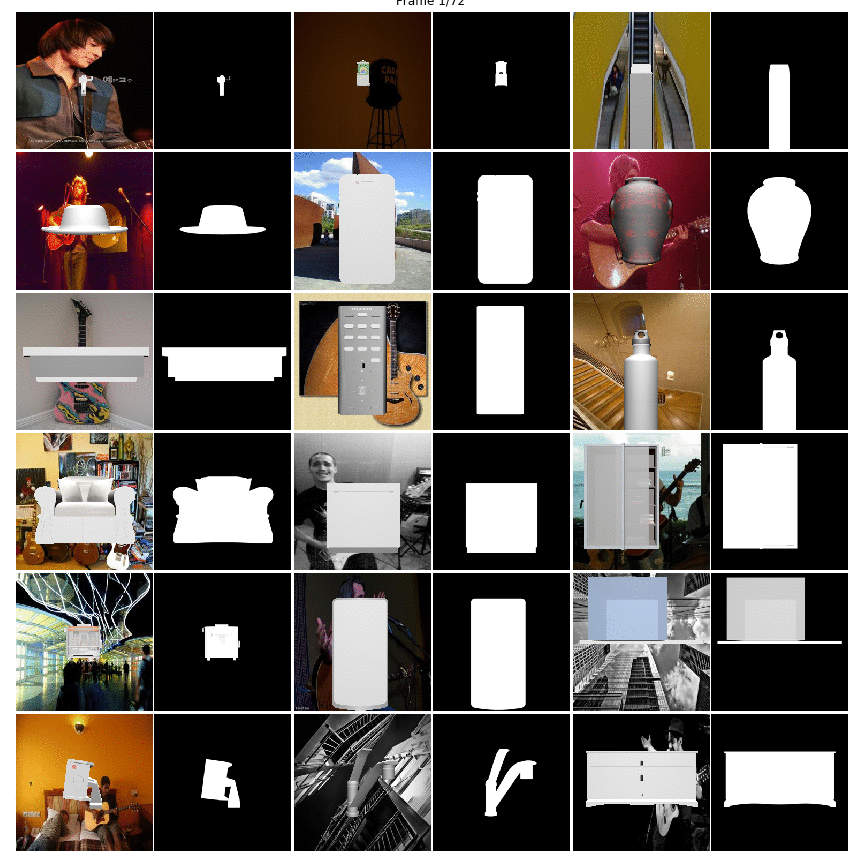

In [139]:
if savepath.endswith('gif'):
    display(Image(filename=savepath))

# Preview Occluded Images

In [ ]:
_LOAD_LIMIT = 18

limit_reached = False

all_imgs = []
rendered_instance_ids = glob.glob(f"{os.path.join(_OUTPUT_ROOT, _RENDER_ENGINE)}/*/*")
np.random.shuffle(rendered_instance_ids)
for rendered_instance_id in rendered_instance_ids:
    sys.stdout.write(f"\rProcessed model {len(all_imgs)+1}/{_LOAD_LIMIT}...")
    sys.stdout.flush()

    # Load paths
    target_img_paths = np.sort(glob.glob(f"{rendered_instance_id}/*_target.png"))
    occluded_img_paths = [ele.replace('_target', '_occluded') for ele in target_img_paths]
    semantic_seg_paths = [ele.replace('_target', '_semseg') for ele in target_img_paths]
    

    # Load images
    target_imgs = [modules.utils.read_image(img_path, parse_mask=True) for img_path in target_img_paths]
    occluded_imgs = [modules.utils.read_image(img_path) for img_path in occluded_img_paths]
    segmentation_imgs = [modules.utils.read_image(img_path) for img_path in semantic_seg_paths]

    # Ensure correct number of view angles present
    if len(target_imgs) != _N_VIEW_ANGLES:
        print(f"\t**Error: Insufficient angles! Actual: {len(target_imgs)} - Expected: {_N_VIEW_ANGLES}")
        continue

    # Setup background image
    background_img = modules.utils.sample_background_img(background_img_paths, shape=target_imgs[0].shape)

    # Apply background image
    target_imgs = [modules.utils.add_background(rgb_img, seg_img, background_img) 
                         for rgb_img, seg_img in target_imgs]
    occluded_imgs = [modules.utils.add_background(rgb_img, seg_img, background_img)
                         for rgb_img, seg_img in zip(occluded_imgs, segmentation_imgs)]

    # Join rgb image with semantic seg image
    joined_imgs = [(target, occluded, mask)
                       for target, occluded, mask in zip(target_imgs, occluded_imgs, segmentation_imgs)]

    # Combine images
    joined_imgs = modules.utils.combine_imgs(joined_imgs)
    all_imgs.append(joined_imgs)

    # Check limit
    if len(all_imgs) >= _LOAD_LIMIT:
        print("\nLimit reached. Ending early.")
        limit_reached = True
        break

In [ ]:
# Stack all images
stacked_imgs = modules.utils.stack_all_imgs(all_imgs, nrow=3)

In [ ]:
savepath = 'test.gif'
animation = modules.utils.toAnimation(stacked_imgs, figsize=(12,12), interval=100, savepath=savepath, fps=15)

In [ ]:
if savepath.endswith('gif'):
    display(Image(filename=savepath))